# Import Libraries

In [ ]:
import numpy as np
import math
# import cv2
# import glob
import os
import pandas as pd
import requests
from io import BytesIO
from PIL import Image
from matplotlib import pyplot as plt
from urllib.request import urlretrieve

from torch.utils.data import Dataset, DataLoader
import torch
from torchvision.transforms import v2
from torchvision import transforms

import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import train_test_split
from skimage.metrics import structural_similarity as ssim
from tqdm import tqdm

# Define helper functions/classes

## Color space transformers functions

In [ ]:


## convert RGB to the personal LAB (LAB2)
# the input R,G,B,  must be 1D from 0 to 255
# the outputs are 1D  L [0 1], a [-1 1] b [-1 1]
def RGB2LAB2(R0, G0, B0):
    import numpy as np
    R=R0/255
    G=G0/255
    B=B0/255

    # Y=0.3*R + 0.59*G + 0.11*B
    # X=0.45*R + 0.35*G + 0.2*B
    # Z=0.01*R + 0.09*G + 0.9*B

    Y=0.299*R + 0.587*G + 0.114*B
    X=0.449*R + 0.353*G + 0.198*B
    Z=0.012*R + 0.089*G + 0.899*B

    # X - Y = 0.150*R - 0.234*G + 0.084*B  = a0
    # Y - Z = 0.287*R + 0.498*G - 0.785*B  = b0

    L = Y
    a = (X - Y)/0.234
    b = (Y - Z)/0.785

    return L, a, b


In [ ]:

## convert the personal LAB (LAB2)to the RGB
# the input L,a,b,  must be 1D L [0 1], a [-1 1] b [-1 1]
# the outputs are 1D  R g B [0 255]
def LAB22RGB(L, a, b):
    import numpy as np
    a11 = 0.299
    a12 = 0.587
    a13 = 0.114
    a21 = (0.15/0.234)
    a22 = (-0.234/0.234)
    a23 = (0.084/0.234)
    a31 = (0.287/0.785)
    a32 = (0.498/0.785)
    a33 = (-0.785/0.785)

    aa=np.array([[a11, a12, a13], [a21, a22, a23], [a31, a32, a33]])
    C0=np.zeros((L.shape[0],3))
    C0[:,0]=L[:,0]
    C0[:,1]=a[:,0]
    C0[:,2]=b[:,0]
    C = np.transpose(C0)
    # C = np.array([L, a, b])
    # print(C.shape)
    # print(L.shape)
    # print(a.shape)
    # print(b.shape)
    # print(aa.shape)

    X = np.linalg.inv(aa).dot(C)
    X1D=np.reshape(X,(X.shape[0]*X.shape[1],1))
    p0=np.where(X1D<0)
    X1D[p0[0]]=0
    p1=np.where(X1D>1)
    X1D[p1[0]]=1
    Xr=np.reshape(X1D,(X.shape[0],X.shape[1]))

    Rr = Xr[0][:]
    Gr = Xr[1][:]
    Br = Xr[2][:]

    R = np.uint(np.round(Rr*255))
    G = np.uint(np.round(Gr*255))
    B = np.uint(np.round(Br*255))
    # p0=np.where(L<0.02)
    # R[p0[0]]=0
    # G[p0[0]]=0
    # B[p0[0]]=0
    # p1=np.where(L>0.98)
    # R[p1[0]]=255
    # G[p1[0]]=255
    # B[p1[0]]=255
    return R, G, B


In [ ]:
def from_LAB_to_RGB_img(L, AB):

    # print("*** Transforming LAB img to RGB ***")
    x_dim, y_dim = L.shape[0], L.shape[1]
    predicted_RGB=np.uint8(np.zeros((x_dim,y_dim,3)))
    AB = np.squeeze(AB)
    # print(f"Shape o AB in conversion is {AB.shape}")
    a0, b0 = AB[:, :, 0], AB[:, :, 1]

    # print(f"{np.squeeze(L).shape}, {a0.shape}, {b0.shape}")

    Rr, Gr, Br = LAB22RGB(L.reshape(-1, 1),
                          a0.reshape(-1, 1),
                          b0.reshape(-1, 1))

    predicted_RGB[:, :,0] = np.reshape(Rr,(x_dim,y_dim))
    predicted_RGB[:, :,1] = np.reshape(Gr,(x_dim,y_dim))
    predicted_RGB[:, :,2] = np.reshape(Br,(x_dim,y_dim))


    return predicted_RGB

In [ ]:
def plot_multiple_imgs(orig_img, imgs, with_orig=True, col_title=None, img_size = 10, font_s = 12, **imshow_kwargs):

    if not isinstance(imgs[0], list):
        # Make a 2d grid even if there's just 1 row
        imgs = [imgs]

    num_rows = len(imgs)
    num_cols = len(imgs[0]) + with_orig
    fig, axs = plt.subplots(nrows=num_rows, ncols=num_cols, squeeze=False, figsize = (img_size, img_size))
    for row_idx, row in enumerate(imgs):
        row = [orig_img] + row if with_orig else row
        for col_idx, img in enumerate(row):
            ax = axs[row_idx, col_idx]
            ax.imshow(np.asarray(img), **imshow_kwargs)
            ax.set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

    # if with_orig:
    #     axs[0, 0].set(title='Original image')
    #     axs[0, 0].title.set_size(8)


    if col_title is not None:
        # for row_idx in range(num_rows):
        #     axs[row_idx, 0].set(ylabel=col_title[row_idx])
        for ax, title in zip(axs.flatten(), col_title):
            ax.set_title(f"{title}", fontsize=font_s)
    else:
        axs[0, 0].set(title='Original image')
        axs[0, 0].title.set_size(font_s)


    plt.tight_layout()

## Metrics functions

In [ ]:

def psnr(img1, img2):
    mse = np.mean( (img1.astype("float") - img2.astype("float")) ** 2 )
    # print(mse)
    if mse == 0:
        return 100
    PIXEL_MAX = 255.0
    return 20 * math.log10(PIXEL_MAX / math.sqrt(mse))


In [ ]:

def mse(imageA, imageB, nband):
	# the 'Mean Squared Error' between the two images is the
	# sum of the squared difference between the two images;
	# NOTE: the two images must have the same dimension
	err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
	err /= float(imageA.shape[0] * imageA.shape[1] * nband)

	# return the MSE, the lower the error, the more "similar"
	# the two images are
	return err


In [ ]:

# def mae(imageA, imageB, bands):
# 	# the 'Mean Absolute Error' between the two images is the
# 	# sum of the squared difference between the two images;
# 	# NOTE: the two images must have the same dimension
# 	err = np.sum(np.abs(imageA.astype("float") - imageB.astype("float")))
# 	err /= float(imageA.shape[0] * imageA.shape[1] * bands)

def rmse(imageA, imageB, nband):
	# the 'Root Mean Squared Error' between the two images is the
	# sum of the squared difference between the two images;
	# NOTE: the two images must have the same dimension
	err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
	err /= float(imageA.shape[0] * imageA.shape[1] * nband)
	err = np.sqrt(err)
	return err


# Load "base" TF model

Load base Hyper-U-Net model from the original source:

- link to [original paper](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC9604844/)

- link to [repository](https://github.com/3DOM-FBK/Hyper_U_Net?tab=readme-ov-file)

- link to [model]("https://drive.usercontent.google.com/download?id=19DaA9f1HIOW9PmUz11xKw65fCo3X7-Fw&export=download&authuser=0&confirm=t&uuid=8a03b6f8-6f5d-4bc8-a62d-8b0cfc98d2db&at=APZUnTU9WqjmYlQcAGh22O2M8wXI%3A1717452655512")

NOTE: This will download a .h5 file to your device in the current directory.

In [ ]:
url = ("https://drive.usercontent.google.com/download?id=19DaA9f1HIOW9PmUz11xKw65fCo3X7-Fw&export=download&authuser=0&confirm=t&uuid=8a03b6f8-6f5d-4bc8-a62d-8b0cfc98d2db&at=APZUnTU9WqjmYlQcAGh22O2M8wXI%3A1717452655512")
filename="Hyper_U_Net.h5"

if not os.path.exists(os.path.join(os.curdir, "Hyper_U_Net.h5")):
    path, headers = urlretrieve(url, filename)
# for name, value in headers.items():
#     print(name, value)
model1 = keras.models.load_model(os.path.join(os.curdir, "Hyper_U_Net.h5"))

# Get Validation data

## Check info from the images

## Define custom Dataset class


In [ ]:
# the idea was borrowed from here: https://towardsdatascience.com/custom-dataset-in-pytorch-part-1-images-2df3152895

class Swisstopodataset(Dataset):
    def __init__(self, img_indx, transform = None, large_dataset=False, return_label = True):
        self.img_indx = img_indx
        self.transform = transform
        self.large_dataset = large_dataset
        self.return_label = return_label
        # self.augment = augment

    def __len__(self):
        return len(self.img_indx)

    def __getitem__(self, idx):
        # img_filepath  = self.img_indx[idx]
        if self.large_dataset:
            port = 1986
        else:
            port = 1985
        raw_data_csv_file_link = f"https://perritos.myasustor.com:{port}/metadata.csv"
        metadata_file = pd.read_csv(raw_data_csv_file_link, index_col=0)
        img_in_server_link = f"https://perritos.myasustor.com:{port}/data/img_id_{self.img_indx[idx]}.jpg"
        response = requests.get(img_in_server_link)
        image = Image.open(BytesIO(response.content))
        # image = cv2.imread(img_filepath)
        # image = Image.fromarray(image)

        # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        # define here a label if existing
        label = metadata_file["class"].iloc[idx]

        if self.transform is not None:
            # print ("*** Transforming RGB img to LAB ***")
            image = self.transform(image)

        # if self.augment is not None:
        #     # print ("*** Applying augmentation on L channel ***")
        #     image_L, imageAB = image
        #     image_L = self.augment(image_L)
        #     image = (image_L, imageAB)


        if self.return_label:
            return image, label
        else:
            return image


## Define transforms


In [ ]:
class convert_RGB_to_feed_model(torch.nn.Module):
    def forward(self, img):
        img = np.asanyarray(img)
        sz_x=img.shape[0]
        sz_y=img.shape[1]

        train_imgs=np.zeros((sz_x,sz_y,2))
        train_input=np.zeros((sz_x,sz_y,1))

        ab=np.zeros((sz_x,sz_y,2))
        R1 = np.reshape(img[:,:,0],(sz_x*sz_y,1))
        G1 = np.reshape(img[:,:,1],(sz_x*sz_y,1))
        B1 = np.reshape(img[:,:,2],(sz_x*sz_y,1))
        L, A, B = RGB2LAB2(R1,G1,B1)
        # A = np.reshape(A,(sz_x,sz_y))
        # B = np.reshape(B,(sz_x,sz_y))
        # ab[:,:,0] = A
        # ab[:,:,1] = B
        # print(f"shape of ab is: {ab.shape}")
        # print(f"shape of L is: {L.shape}")
        # train_input[:,:,:] =  np.reshape(L,(1,sz_x,sz_y,1))
        # train_imgs[:,:,:] = np.reshape(ab,(1,sz_x,sz_y,2))

        train_input[:,:,0] = L.reshape((sz_x,sz_y))
        train_imgs[:,:,0] = np.reshape(A,(sz_x,sz_y))
        train_imgs[:,:,1] = np.reshape(B,(sz_x,sz_y))

        # print(f"shape of train_input is: {train_input.shape}")
        # print(f"shape of train_imgs is: {train_imgs.shape}")

        return (train_input, train_imgs)

In [ ]:
# We set to 20% of images will be subject to transformation
perc_apply_trasnform = 0.2


# This transformation will only change the image colorspace from RGB->LAB
RGBtoLAB_transforms = transforms.Compose(
    [
        # v2.ToImage(), # convert to tensor if you have a PIL image. NOTE: when you do this it convert the image automatically to RGB!!! Be carefull!
        convert_RGB_to_feed_model(),
    ]
)

augment_transform = transforms.Compose(
    [
        # v2.ToImage(), # convert to tensor if you have a PIL image. NOTE: when you do this it convert the image automatically to RGB!!! Be carefull!
        v2.RandomHorizontalFlip(p=perc_apply_trasnform),
        v2.RandomHorizontalFlip(p=perc_apply_trasnform),
        v2.ColorJitter(brightness = 0.5),
        v2.ColorJitter(contrast = 0.5),
        convert_RGB_to_feed_model(),

    ]
)


## Split the Train, Valid and Test subsets.

The data was initially created using the scripts `retrieve_data.ipynb` and stored in a private server for later (re)use.
In the metadata.csv file we get the information on original link, class and coordinates of each image.

NOTE: the following are links stored in a private server, jet they are still publically available.

In [ ]:
is_large_dataset = True

if is_large_dataset:
    server_port = 1986 # Large dataset of ~10K images
else:
    server_port = 1985 # Large dataset of ~10K images
# server_port = 1985 # initial dataset of 3.6K images

raw_data_csv_file_link = f"https://perritos.myasustor.com:{server_port}/metadata.csv"


metadata_raw_df = pd.read_csv(raw_data_csv_file_link, index_col=0)
metadata_raw_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10008 entries, 0 to 10007
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   img_id      10008 non-null  int64  
 1   img_name    10008 non-null  object 
 2   latitude    10008 non-null  float64
 3   longitude   10008 non-null  float64
 4   zoom_level  10008 non-null  int64  
 5   class       10008 non-null  int64  
 6   link        10008 non-null  object 
dtypes: float64(2), int64(3), object(2)
memory usage: 625.5+ KB


We use the column `image_id` from the metadata as index of the images and then we perform standard shufling and splitting.

The final ratio for the train, validation and test dastasets are: 70, 29 and 1 % respectively

In [ ]:
dataX, dataY = metadata_raw_df["img_id"].to_list(), metadata_raw_df["class"] .to_list()

rand_state = 9898

train_ratio = 0.70
validation_ratio = 0.29
test_ratio = 0.01



# train is now 75% of the entire data set
x_train, x_test, y_train, y_test = train_test_split(dataX, dataY, test_size=1 - train_ratio, stratify = dataY, random_state=rand_state)

# test is now 10% of the initial data set
# validation is now 15% of the initial data set
x_val, x_test, y_val, y_test,= train_test_split(x_test, y_test, test_size=test_ratio/(test_ratio + validation_ratio), stratify=y_test, random_state=rand_state)

print(f"the size fo the train dataset is: {len(x_train)}.\nthe size fo the validation dataset is: {len(x_val)}.\nthe size fo the test dataset is: {len(x_test)}.")

the size fo the train dataset is: 7005.
the size fo the validation dataset is: 2902.
the size fo the test dataset is: 101.


In [ ]:
train_dataset = Swisstopodataset(x_train,
                                 large_dataset=is_large_dataset,
                                 return_label=False,
                                 transform=augment_transform)

valid_dataset= Swisstopodataset(x_val,
                                 large_dataset=is_large_dataset,
                                 return_label=False,
                                 transform=augment_transform)

test_dataset= Swisstopodataset(x_test,
                                 large_dataset=is_large_dataset,
                                 return_label=False,
                                 transform=RGBtoLAB_transforms) # NOTE: in the test dataset we dont apply any transformation, just transform to LAB.

print([f"the size of the dataset '{name}' is: {len(i)}" for i, name in zip([train_dataset,
                                                                            valid_dataset,
                                                                            test_dataset],
                                                                            ["train_dataset",
                                                                             "valid_dataset",
                                                                             "test_dataset"])])

["the size of the dataset 'train_dataset' is: 7005", "the size of the dataset 'valid_dataset' is: 2902", "the size of the dataset 'test_dataset' is: 101"]


# Compute metrics

Here we create the main loop to compute the metrics.

- We use the *Test* tadates of about 100 images.

- First we pass the L channel (grey image) to the model to make the prediction.

- Then we transform the **original** AND the **predicted** L\*a\*b images to RGB colorspace and plot them to compare results.

- Finally we compute a number of metrics and summarize the results in a dataframe

evaluating model:  20%|█▉        | 20/101 [01:44<06:23,  4.73s/it]<ipython-input-5-d1a409f02c34>:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(nrows=num_rows, ncols=num_cols, squeeze=False, figsize = (img_size, img_size))
evaluating model: 100%|██████████| 101/101 [08:17<00:00,  4.93s/it]


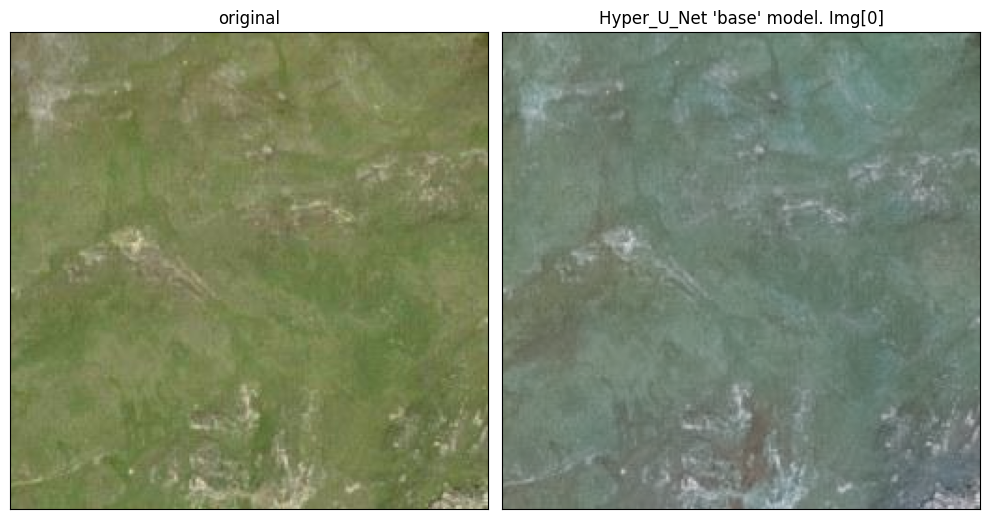

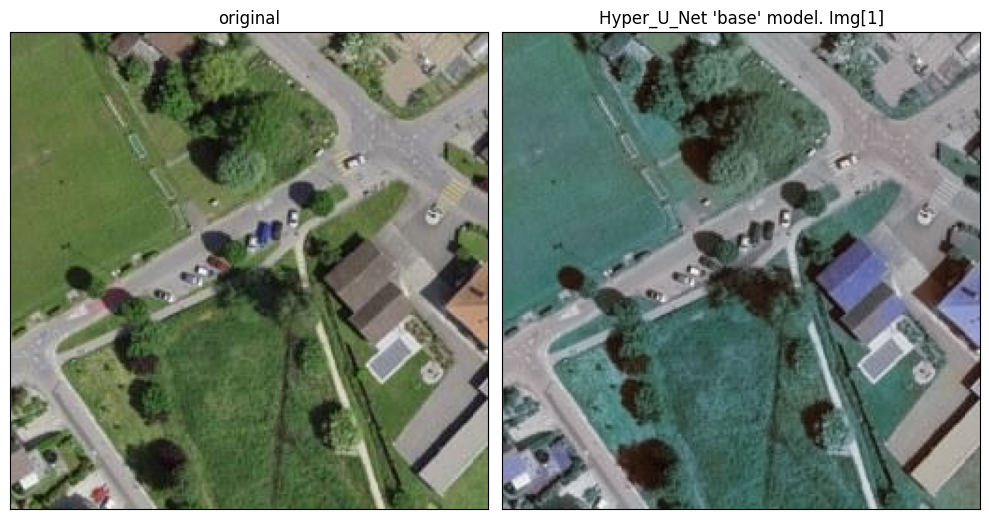

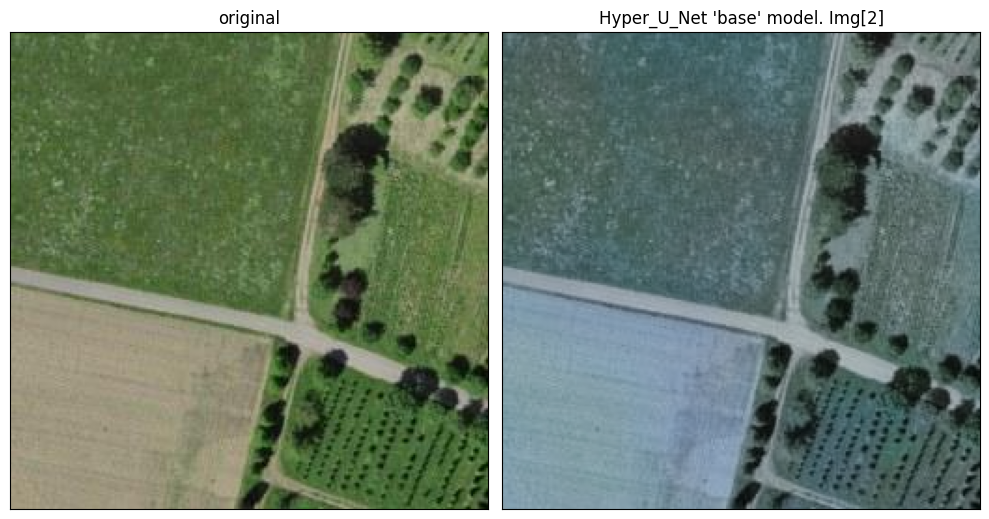

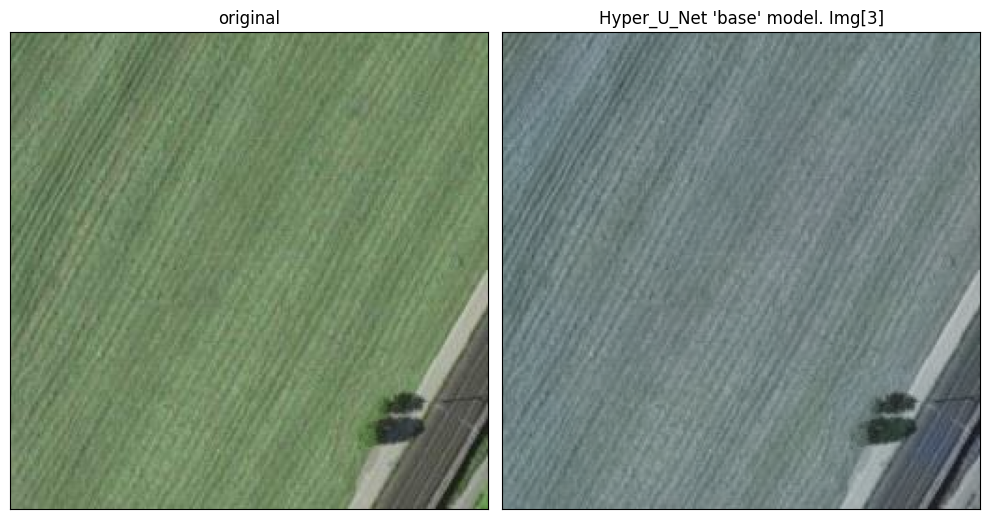

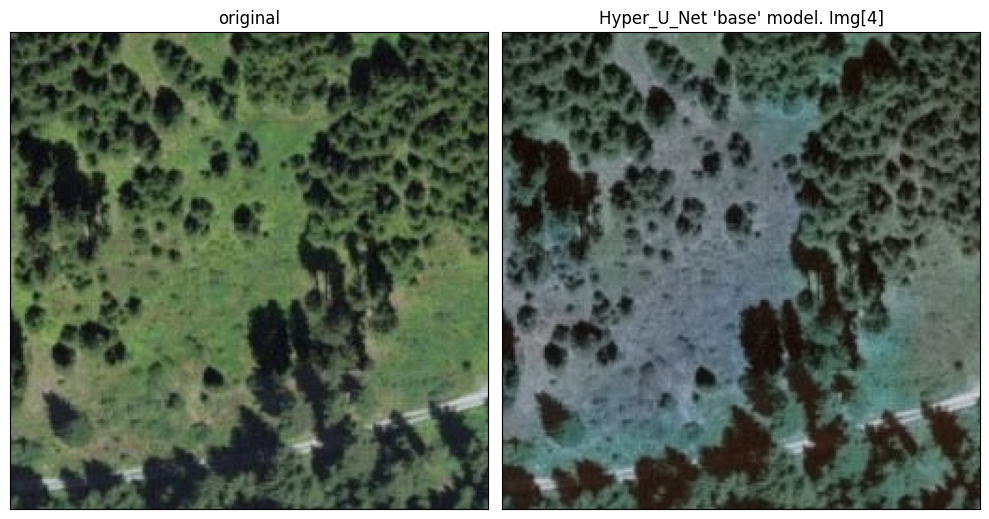

...

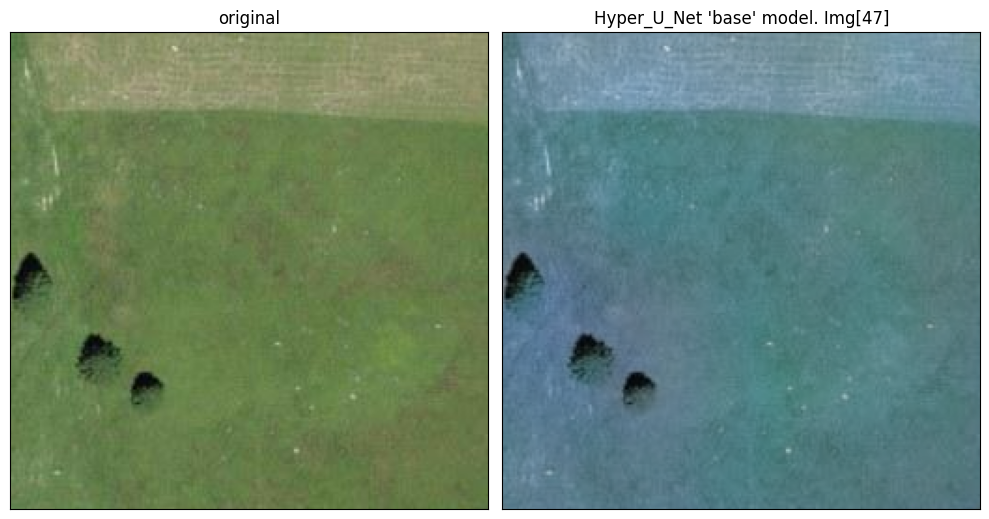

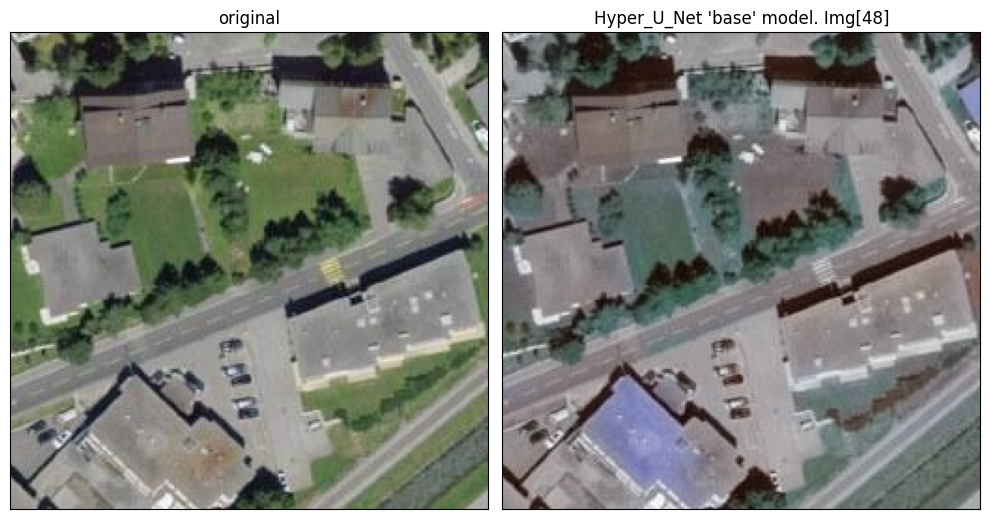

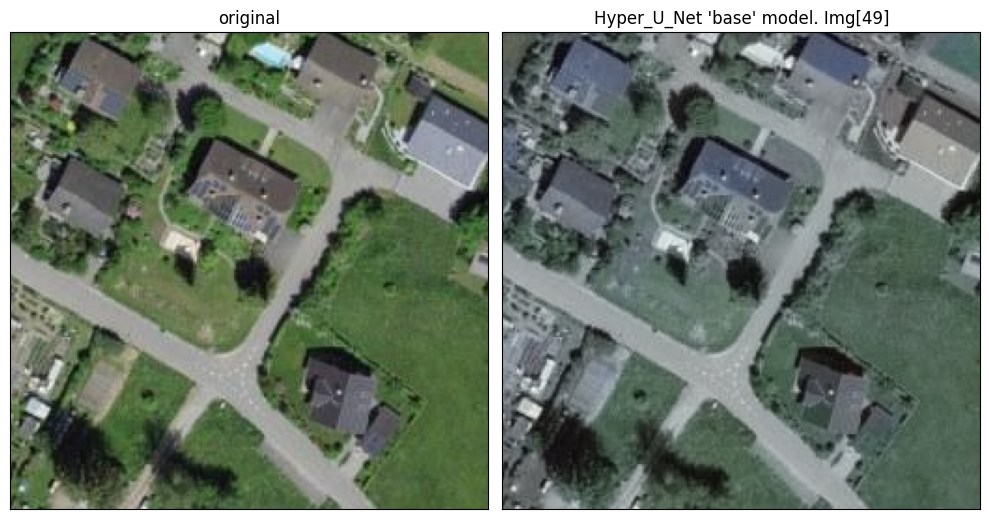

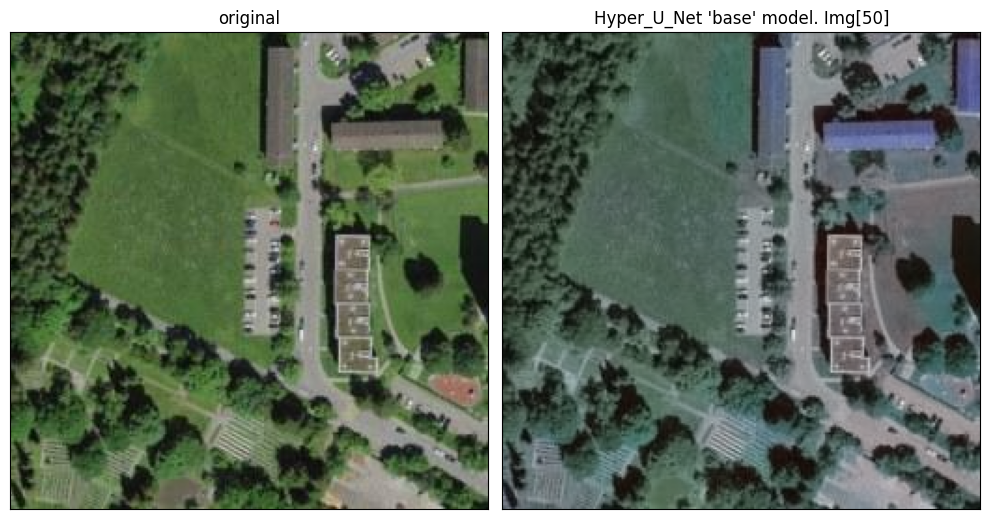

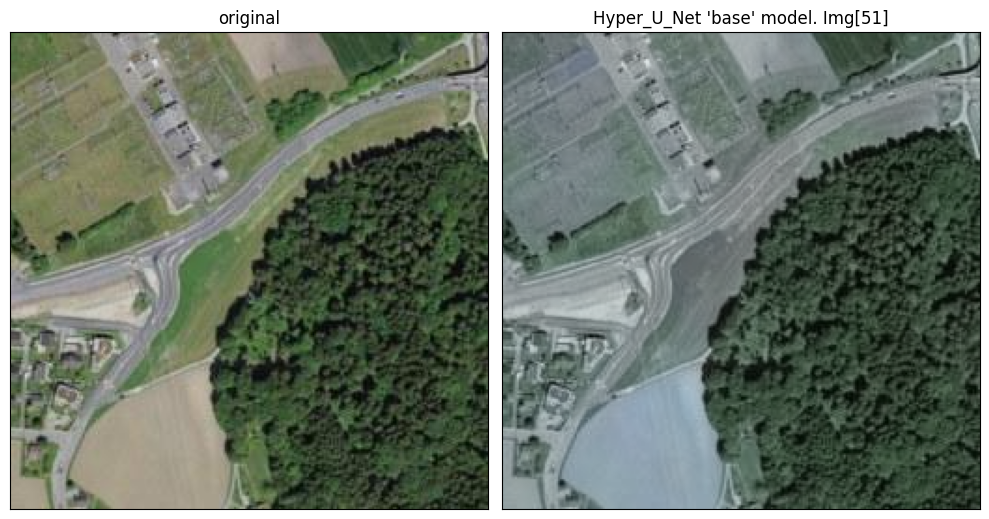

In [ ]:
MSE_list = []
MSEr_list = []
MSEg_list = []
MSEb_list = []
RMSE_list = []
PSNR_list = []
SSIM_list = []

# n_imgs_to_test = 10
n_imgs_to_test = len(test_dataset)

for i in tqdm(range(n_imgs_to_test), desc = "evaluating model", total=n_imgs_to_test):
    L, AB = test_dataset[i]
    # print(f"L shape: {L.shape}")
    # print(f"AB shape: {AB.shape}")


    # print("*** Predicting ***")
    predicted_AB = model1.predict(np.expand_dims(L, 0), verbose=0)
    # print(predicted_AB.shape)
    # a0 = predicted[:,0:1]
    # b0 = predicted[:,1:2]
    predicted_RGB = from_LAB_to_RGB_img(L, predicted_AB)
    # print(f"Shape of RGB reconstructed is :{predicted_RGB.shape}")
    original_RGB = from_LAB_to_RGB_img(L, AB)
    # print(f"Shape of original RGB is :{original_RGB.shape}")
    # print("*** Computing metrics ***")
    MSE = mse(original_RGB,predicted_RGB,3)
    MSEr = mse(original_RGB[:,:,0],predicted_RGB[:,:,0],1)
    MSEg = mse(original_RGB[:,:,1],predicted_RGB[:,:,1],1)
    MSEb = mse(original_RGB[:,:,2],predicted_RGB[:,:,2],1)
    RMSE = rmse(original_RGB,predicted_RGB,3) # mae(imagt255,predicted_RGB,bands)
        # PSNR = tf.image.psnr(, predicted_RGB , max_val=255)
    PSNR=psnr(original_RGB,predicted_RGB)
    SSIM, _ = ssim(original_RGB, predicted_RGB, channel_axis=2, full=True) # NOTE: need to specify axis channels, otherwise complains!

    MSE_list.append(MSE)
    MSEr_list.append(MSEr)
    MSEg_list.append(MSEg)
    MSEb_list.append(MSEb)
    RMSE_list.append(RMSE)
    SSIM_list.append(SSIM)
    PSNR_list.append(PSNR)
    plot_multiple_imgs(original_RGB, [predicted_RGB],
               col_title=["original", f"Hyper_U_Net 'base' model. Img[{i}]"])

    # id_Ac = id_Ac + 1


    # break


In [ ]:
metrics_df = pd.DataFrame({
    "Model": "Hyper_UNet_base",
    "MSE" : MSE_list,
    "PSNR" : PSNR_list,
    "MSEr" : MSEr_list,
    "MSEg" : MSEg_list,
    "MSEb" : MSEb_list,
    "RMSE" : RMSE_list,
    "SSIM" : SSIM_list,
})


Compute the mean

In [ ]:

metrics_df.groupby("Model").mean().round(2)

Compute the SD

In [ ]:
metrics_df.groupby("Model").std().round(2)

# Compute metrics

Here we create the main loop to compute the metrics.

- We use the *Test* tadates of about 100 images.

- First we pass the L channel (grey image) to the model to make the prediction.

- Then we transform the **original** AND the **predicted** L\*a\*b images to RGB colorspace and plot them to compare results.

- Finally we compute a number of metrics and summarize the results in a dataframe

In [ ]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

In [ ]:
from tensorflow.keras.models import load_model

# Path to the saved model
model_path = '/content/drive/My Drive/CAS Advanced Machine Learning/Luftbild_Colorization/Retrained_Hyper_U_Net.h5'

# Load the model
model2 = load_model(model_path)

# Now the loaded_model contains your previously trained model

In [ ]:
MSE_list = []
MSEr_list = []
MSEg_list = []
MSEb_list = []
RMSE_list = []
PSNR_list = []
SSIM_list = []

# n_imgs_to_test = 10
n_imgs_to_test = len(test_dataset)

for i in tqdm(range(n_imgs_to_test), desc = "evaluating model", total=n_imgs_to_test):
    L, AB = test_dataset[i]
    # print(f"L shape: {L.shape}")
    # print(f"AB shape: {AB.shape}")


    # print("*** Predicting ***")
    predicted_AB = model2.predict(np.expand_dims(L, 0), verbose=0)
    # print(predicted_AB.shape)
    # a0 = predicted[:,0:1]
    # b0 = predicted[:,1:2]
    predicted_RGB = from_LAB_to_RGB_img(L, predicted_AB)
    # print(f"Shape of RGB reconstructed is :{predicted_RGB.shape}")
    original_RGB = from_LAB_to_RGB_img(L, AB)
    # print(f"Shape of original RGB is :{original_RGB.shape}")
    # print("*** Computing metrics ***")
    MSE = mse(original_RGB,predicted_RGB,3)
    MSEr = mse(original_RGB[:,:,0],predicted_RGB[:,:,0],1)
    MSEg = mse(original_RGB[:,:,1],predicted_RGB[:,:,1],1)
    MSEb = mse(original_RGB[:,:,2],predicted_RGB[:,:,2],1)
    RMSE = rmse(original_RGB,predicted_RGB,3) # mae(imagt255,predicted_RGB,bands)
        # PSNR = tf.image.psnr(, predicted_RGB , max_val=255)
    PSNR=psnr(original_RGB,predicted_RGB)
    SSIM, _ = ssim(original_RGB, predicted_RGB, channel_axis=2, full=True) # NOTE: need to specify axis channels, otherwise complains!

    MSE_list.append(MSE)
    MSEr_list.append(MSEr)
    MSEg_list.append(MSEg)
    MSEb_list.append(MSEb)
    RMSE_list.append(RMSE)
    SSIM_list.append(SSIM)
    PSNR_list.append(PSNR)
    plot_multiple_imgs(original_RGB, [predicted_RGB],
               col_title=["original", f"Hyper_U_Net 'retrained' model. Img[{i}]"])

    # id_Ac = id_Ac + 1


    # break


In [ ]:
metrics_df = pd.DataFrame({
    "Model": "Hyper_UNet_retrained",
    "MSE" : MSE_list,
    "PSNR" : PSNR_list,
    "MSEr" : MSEr_list,
    "MSEg" : MSEg_list,
    "MSEb" : MSEb_list,
    "RMSE" : RMSE_list,
    "SSIM" : SSIM_list,
})


Compute the mean

In [ ]:

metrics_df.groupby("Model").mean().round(2)

Compute the SD

In [ ]:
metrics_df.groupby("Model").std().round(2)